<a href="https://colab.research.google.com/github/pang-lee/CNN-RNN_baseball_movemnet_classfication/blob/main/cnn_RNN_new.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This example demonstrates video classification. It is an important use-case with applications in surveillance, security, and so on. The dataset consists of videos categorized into different actions like cricket shot, punching, biking, etc. This is why the dataset is known to build action recognizers which is just an extension of video classification.

A video is made of an ordered sequence of frames. While the frames constitue **spatiality** the sequence of those frames constitute the **temporality** of a video. To systematically model both of these aspects we generally use a hybrid architecture that consists of convolutions (for spatiality) as well as recurrent layers (for temporality). In this example, we will be using such a hybrid architecture consisting of a Convolutional Neural Network (CNN) and a Recurrent Neural Network (RNN) consisting of [GRU layers](https://keras.io/api/layers/recurrent_layers/gru/). These kinds of hybrid architectures are popularly known as **CNN-RNN**. 

This example requires TensorFlow 2.4 or higher, as well as TensorFlow Docs, which can be installed using the following command:

## Data collection

In order to keep the runtime of this example relatively short, we will be using a subsampled version of the original UCF101 dataset. You can refer to [this notebook](https://github.com/sayakpaul/Action-Recognition-in-TensorFlow/blob/main/Data_Preparation_UCF101.ipynb) to know how the subsampling was done. 

And The code is reference by: https://github.com/sayakpaul/Action-Recognition-in-TensorFlow/blob/main/Video_Classification.ipynb

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!cp ./drive/'My Drive'/BA_DATA.zip ./
!mkdir BA_DATA
!unzip BA_DATA.zip -d BA_DATA/dataset

Mounted at /content/drive
Archive:  BA_DATA.zip
   creating: BA_DATA/dataset/三振/
  inflating: BA_DATA/dataset/三振/220701_1-10.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-18.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-18_2.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-18_3.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-18_4.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-18_5.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-18_6.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-18_7.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-18_8.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-18_9.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-19.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-19_2.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-19_3.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-19_4.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-19_5.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-19_6.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-4.mp4  
  inflating: BA_DATA/dataset/三振/220701_1-4_2

## Setup

In [ ]:
from tensorflow import keras
from imutils import paths
import matplotlib.pyplot as plt
import tensorflow as tf

import pandas as pd 
import numpy as np
import imageio
import cv2
import os
from tqdm import tqdm
import shutil
import datetime
from IPython.display import Image
from keras.utils.vis_utils import plot_model
from IPython.display import clear_output
from google.colab.patches import cv2_imshow

## Define hyperparameters

In [ ]:
IMG_SIZE = 224
BATCH_SIZE = 1

EPOCHS = 50

MAX_SEQ_LENGTH = 200
NUM_FEATURES = 2048

## Data preparation

In [ ]:
basePath = os.getcwd()+ '/BA_DATA/dataset'
baseall_data_path = './drive/MyDrive/baseball_data'

train_data = []
random_data = []

for file in os.listdir(basePath):
  for filename in os.listdir(os.path.join(basePath, file)):
    if filename.endswith("mp4"):
      train_data.append({
          'video_name': filename,
          'tag': file
      })

for file in os.listdir(baseall_data_path):
  if(file != '4月' and file != '5月' and file != '6月' and file != '0723_2-6.mp4'):
    for filename in os.listdir(os.path.join(baseall_data_path, file)):
      if filename.endswith("mp4"):
        random_data.append({
            'video_name': filename,
            'tag': 'none',
            'file': file
        })

print(train_data, random_data)
train_df = pd.DataFrame(train_data)
test_df = train_df.sample(30)
test_df.index=range(30)
random_df = pd.DataFrame(random_data).sample(15)
random_df.index=range(15)

train_df, test_df, random_df

[{'video_name': '220701_1-18.mp4', 'tag': '三振'}, {'video_name': '220701_1-10.mp4', 'tag': '三振'}, {'video_name': '220701_1-4.mp4', 'tag': '三振'}, {'video_name': '220701_1-19_5.mp4', 'tag': '三振'}, {'video_name': '220701_1-4_2.mp4', 'tag': '三振'}, {'video_name': '220702_2-14.mp4', 'tag': '三振'}, {'video_name': '220701_1-19_3.mp4', 'tag': '三振'}, {'video_name': '220701_1-18_7.mp4', 'tag': '三振'}, {'video_name': '220701_1-18_5.mp4', 'tag': '三振'}, {'video_name': '220701_1-19_2.mp4', 'tag': '三振'}, {'video_name': '220701_1-19_4.mp4', 'tag': '三振'}, {'video_name': '220701_1-18_9.mp4', 'tag': '三振'}, {'video_name': '220701_1-19.mp4', 'tag': '三振'}, {'video_name': '220702_2-14_2.mp4', 'tag': '三振'}, {'video_name': '220701_1-18_6.mp4', 'tag': '三振'}, {'video_name': '220701_1-18_3.mp4', 'tag': '三振'}, {'video_name': '220701_1-18_2.mp4', 'tag': '三振'}, {'video_name': '220701_1-19_6.mp4', 'tag': '三振'}, {'video_name': '220701_1-4_3.mp4', 'tag': '三振'}, {'video_name': '220701_1-18_4.mp4', 'tag': '三振'}, {'video_name

(           video_name   tag
 0     220701_1-18.mp4    三振
 1     220701_1-10.mp4    三振
 2      220701_1-4.mp4    三振
 3   220701_1-19_5.mp4    三振
 4    220701_1-4_2.mp4    三振
 5     220702_2-14.mp4    三振
 6   220701_1-19_3.mp4    三振
 7   220701_1-18_7.mp4    三振
 8   220701_1-18_5.mp4    三振
 9   220701_1-19_2.mp4    三振
 10  220701_1-19_4.mp4    三振
 11  220701_1-18_9.mp4    三振
 12    220701_1-19.mp4    三振
 13  220702_2-14_2.mp4    三振
 14  220701_1-18_6.mp4    三振
 15  220701_1-18_3.mp4    三振
 16  220701_1-18_2.mp4    三振
 17  220701_1-19_6.mp4    三振
 18   220701_1-4_3.mp4    三振
 19  220701_1-18_4.mp4    三振
 20  220701_1-18_8.mp4    三振
 21  220702_2-14_6.mp4  純粹高飛
 22  220702_2-14_7.mp4  純粹高飛
 23    220702_2-14.mp4  純粹高飛
 24  220702_2-14_4.mp4  純粹高飛
 25  220702_2-14_3.mp4  純粹高飛
 26  220702_2-14_2.mp4  純粹高飛
 27  220702_2-14_5.mp4  純粹高飛
 28     220702_2-5.mp4  純粹滾地
 29    220701_1-16.mp4  純粹滾地
 30    220702_2-14.mp4  純粹滾地
 31     220701_1-2.mp4  純粹滾地
 32     220701_1-5.mp4  純粹滾地
 33     220701

In [ ]:
def move_videos(df, output_dir):
    if not os.path.exists(output_dir):
        os.mkdir(output_dir)

    if output_dir == 'train' or output_dir == 'test':
      for i in tqdm(range(df.shape[0])):
          path = "BA_DATA/dataset/" + df['tag'] + '/' + df['video_name']
          shutil.copy2(path.astype("string")[i], output_dir)
    
    if output_dir == 'random':
      for i in tqdm(range(df.shape[0])):
          path = "drive/MyDrive/baseball_data/" + df['file'] + '/' + df['video_name']
          shutil.copy2(path.astype("string")[i], output_dir)
          
    print()
    print(f"Total videos: {len(os.listdir(output_dir))}")

move_videos(train_df, "train")
move_videos(test_df, "test")
move_videos(random_df, "random")

100%|██████████| 35/35 [00:00<00:00, 65.46it/s]



Total videos: 32


100%|██████████| 30/30 [00:01<00:00, 23.52it/s]



Total videos: 28


100%|██████████| 15/15 [00:30<00:00,  2.05s/it]


Total videos: 15


One of the many challenges of training video classifiers is figuring out a way to feed the videos to a network. [This blog post](https://blog.coast.ai/five-video-classification-methods-implemented-in-keras-and-tensorflow-99cad29cc0b5) discusses five such methods. As a video is an ordered sequence of frames, we can extract the frames, organize them, and then feed them to our network. But the number of frames may differ which would not allow mini-batch learning. To account for all these factors, we can do the following:

1. Capture the frames of a video. 
2. Extract frames from the videos until a maximum frame count is reached.
3. In the case, where a video's frame count is lesser than the maximum frame count we will pad the video with zeros.

Note that this workflow is identical to [problems involving texts sequences](https://developers.google.com/machine-learning/guides/text-classification/). Videos of the UCF101 dataset is [known](https://www.crcv.ucf.edu/papers/UCF101_CRCV-TR-12-01.pdf) to not contain extreme variations in objects and actions across frames. Because of this, it may be okay to only consider a few frames for the learning task. But this approach may not generalize well to other video classification problems. We will be using [OpenCV's `VideoCapture()` method](https://docs.opencv.org/master/dd/d43/tutorial_py_video_display.html) to read frames from videos. 

In [ ]:
# The following two methods are taken from this tutorial:
# https://www.tensorflow.org/hub/tutorials/action_recognition_with_tf_hub
def crop_center_square(frame):
        y, x = frame.shape[0:2]
        min_dim = min(y, x)
        start_x = (x // 2) - (min_dim // 2)
        start_y = (y // 2) - (min_dim // 2)
        return frame[start_y : start_y+min_dim, start_x : start_x+min_dim]

def load_video(path, max_frames=0, resize=(IMG_SIZE, IMG_SIZE)):
    cap = cv2.VideoCapture(path)
    frames = []
    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                break
            frame = crop_center_square(frame)
            frame = cv2.resize(frame, resize)
            frame = frame[:, :, [2, 1, 0]]

            # cv2_imshow(frame)
            # clear_output(wait=True)

            frames.append(frame)

            if len(frames) == max_frames:
                break
    finally:
        cap.release()
    return np.array(frames) 

We can use a pre-trained network to extract meaningful features from the extracted frames. The [`Applications`](https://keras.io/api/applications/) class of Keras provides a number of state-of-the-art models pre-trained on the [ImageNet-1k dataset](http://image-net.org/). We will be using the [InceptionV3 model](https://arxiv.org/abs/1512.00567) for this purpose.

In [ ]:
def build_feature_extractor():
    feature_extractor = keras.applications.InceptionV3(weights="imagenet", include_top=False, pooling="avg", input_shape=(IMG_SIZE, IMG_SIZE, 3))
    preprocess_input = keras.applications.inception_v3.preprocess_input

    inputs = keras.Input((IMG_SIZE, IMG_SIZE, 3))
    preprocessed = preprocess_input(inputs)

    outputs = feature_extractor(preprocessed)
    return keras.Model(inputs, outputs, name="feature_extractor")

feature_extractor = build_feature_extractor()

87924736/87910968 [==============================] - 1s 0us/step


The labels of the videos are strings and since neural networks can not process strings we need to convert these labels into integers. Here we will use the [`StringLookup`](https://keras.io/api/layers/preprocessing_layers/categorical/string_lookup) layer to encode the class labels as integers.

In [ ]:
label_processor = keras.layers.experimental.preprocessing.StringLookup(num_oov_indices=0, vocabulary=np.unique(train_df["tag"]))
print(label_processor.get_vocabulary())

['三振', '純粹滾地', '純粹高飛']


Finally, we can put all the pieces together to create our data processing utility. 

In [ ]:
def prepare_all_videos(df, root_dir):
    num_samples = len(df)
    video_paths = df["video_name"].values.tolist()
    labels = df["tag"].values
    labels = label_processor(labels[..., None]).numpy()
    
    # `frame_masks` and `frame_features` are what we will feed to our sequence model.
    # `frame_masks` will contain a bunch of booleans denoting if a timestep is
    # masked with padding or not.
    frame_masks = np.zeros(shape=(num_samples, MAX_SEQ_LENGTH), dtype="bool")
    frame_features = np.zeros(shape=(num_samples, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32")
    
    # For each video.
    for idx, path in enumerate(video_paths):
        # Gather all its frames and add a batch dimension.
        frames = load_video(os.path.join(root_dir, path))
        frames = frames[None, ...]
        
        # Initialize placeholders to store the masks and features of the current video. 
        temp_frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH, ), dtype="bool")
        temp_frame_featutes = np.zeros(shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32")
        
        # Extract features from the frames of the current video. 
        for i, batch in enumerate(frames):  
            video_length = batch.shape[0]
            length = min(MAX_SEQ_LENGTH, video_length)  
            for j in range(length):
                temp_frame_featutes[i, j, :] = feature_extractor.predict(batch[None, j, :])  
            temp_frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

        frame_features[idx, ] = temp_frame_featutes.squeeze()
        frame_masks[idx, ] = temp_frame_mask.squeeze()

    return (frame_features, frame_masks), labels
    
train_data, train_labels = prepare_all_videos(train_df, "train")
test_data, test_labels = prepare_all_videos(test_df, "test")

print(f"Frame features in train set: {train_data[0].shape}")
print(f"Frame masks in train set: {train_data[1].shape}")

Frame features in train set: (35, 200, 2048)
Frame masks in train set: (35, 200)


The above code block will take ~20 minutes to execute depending on the machine it's being executed. 

## The sequence model

Now, we can feed this data to a sequence model consisting of recurrent layers like `GRU`. 

In [ ]:
!mkdir exec_result

def plot_history(history, result_dir):
    plt.plot(history.history['accuracy'], marker='.')
    plt.plot(history.history['val_accuracy'], marker='.')
    plt.title('model accuracy')
    plt.xlabel('epoch')
    plt.ylabel('accuracy')
    plt.grid()#生成網格
    plt.legend(['acc', 'val_acc'], loc='lower right')
    plt.savefig(os.path.join(result_dir, 'model_accuracy.png'))
    # plt.show()
    plt.close()

    plt.plot(history.history['loss'], marker='.')
    plt.plot(history.history['val_loss'], marker='.')
    plt.title('model loss')
    plt.xlabel('epoch')
    plt.ylabel('loss')
    plt.grid()
    plt.legend(['loss', 'val_loss'], loc='upper right')
    plt.savefig(os.path.join(result_dir, 'model_loss.png'))
    # plt.show()
    plt.close()

def save_history(history, result_dir):
    loss = history.history['loss']
    acc = history.history['accuracy']
    val_loss = history.history['val_loss']
    val_acc = history.history['val_accuracy']
    nb_epoch = len(acc)

    with open(os.path.join(result_dir, 'result.txt'), 'w') as fp:
        fp.write('epoch\tloss\tacc\tval_loss\tval_acc\n')
        for i in range(nb_epoch):
            fp.write('{}\t{}\t{}\t{}\t{}\n'.format(
                i, loss[i], acc[i], val_loss[i], val_acc[i]))

In [ ]:
# Utility for our sequence model.
def get_sequence_model(): 
    class_vocab = label_processor.get_vocabulary()

    frame_features_input = keras.Input((MAX_SEQ_LENGTH, NUM_FEATURES))
    mask_input = keras.Input((MAX_SEQ_LENGTH,), dtype="bool")

    # Refer to the following tutorial to understand the significance of using `mask`:
    # https://keras.io/api/layers/recurrent_layers/gru/
    x = keras.layers.GRU(16, return_sequences=True)(frame_features_input, mask=mask_input)
    x = keras.layers.GRU(8)(x)
    x = keras.layers.Dropout(0.4)(x)
    x = keras.layers.Dense(8, activation="relu")(x)
    output = keras.layers.Dense(len(class_vocab), activation="softmax")(x)

    rnn_model = keras.Model([frame_features_input, mask_input], output)

    rnn_model.compile(loss="sparse_categorical_crossentropy", optimizer="adam", metrics=["accuracy"])
    
    rnn_model.summary()
    plot_model(rnn_model, show_shapes=True, to_file=os.path.join(os.getcwd() + '/exec_result', 'model_rnn.png'))

    return rnn_model

# Utility for running experiments.
def run_experiment():
    filepath = "/tmp/video_classifier"
    checkpoint = keras.callbacks.ModelCheckpoint(filepath, save_weights_only=True, save_best_only=True, verbose=1)

    seq_model = get_sequence_model()
    history = seq_model.fit([train_data[0], train_data[1]], train_labels, validation_split=0.3, batch_size=BATCH_SIZE, epochs=EPOCHS, callbacks=[checkpoint])
    
    plot_history(history, os.getcwd() + '/exec_result')
    save_history(history, os.getcwd() + '/exec_result')

    seq_model.load_weights(filepath)
    _, accuracy = seq_model.evaluate([test_data[0], test_data[1]], test_labels)
    print(f"Test accuracy: {round(accuracy * 100, 2)}%")

    return history, seq_model

_, sequence_model = run_experiment()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_9 (InputLayer)           [(None, 200, 2048)]  0           []                               
                                                                                                  
 input_10 (InputLayer)          [(None, 200)]        0           []                               
                                                                                                  
 gru_6 (GRU)                    (None, 200, 16)      99168       ['input_9[0][0]',                
                                                                  'input_10[0][0]']               
                                                                                                  
 gru_7 (GRU)                    (None, 8)            624         ['gru_6[0][0]']            

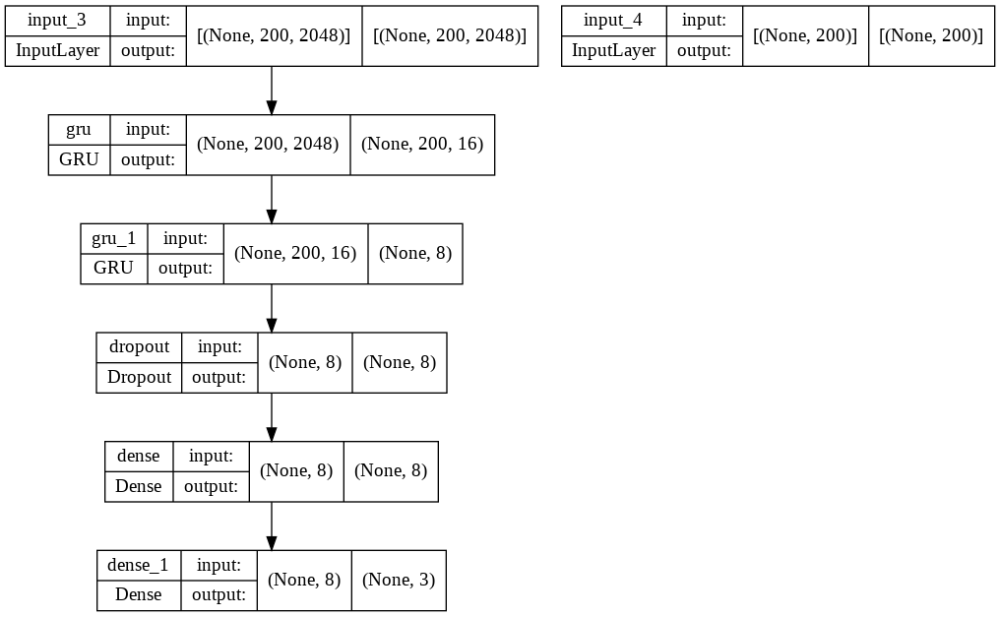

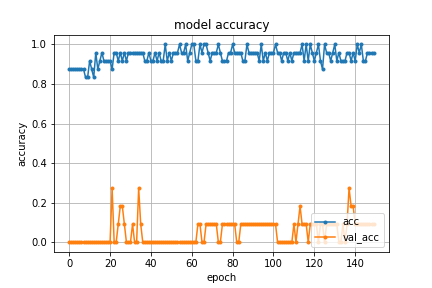

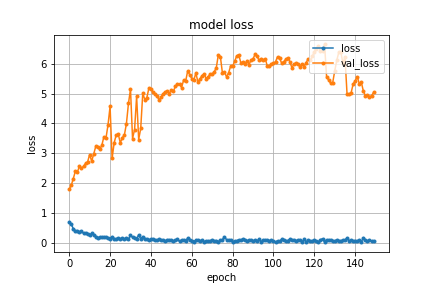

In [ ]:
for file in os.listdir(os.getcwd() + '/exec_result'):
    if file.endswith("png"):
      filename = os.getcwd() + '/exec_result/' + file
      img = cv2.imread(filename)
      cv2_imshow(img)

## Inference

In [ ]:
def prepare_single_video(frames):
    frames = frames[None, ...]
    frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH, ), dtype="bool")
    frame_featutes = np.zeros(shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32")
    
    for i, batch in enumerate(frames):
        video_length = batch.shape[1]
        length = min(MAX_SEQ_LENGTH, video_length)  
        for j in range(length):
            frame_featutes[i, j, :] = feature_extractor.predict(batch[None, j, :])  
        frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

    return frame_featutes, frame_mask

def sequence_prediction(path, folder):
    class_vocab = label_processor.get_vocabulary()

    if folder == 'test':
      frames = load_video(os.path.join("test", path))
    if folder == 'random':
      frames = load_video(os.path.join("random", path))
    
    frame_features, frame_mask = prepare_single_video(frames)
    probabilities = sequence_model.predict([frame_features, frame_mask])[0]
    
    for i in np.argsort(probabilities)[::-1]:
        print(f"  {class_vocab[i]}: {probabilities[i] * 100:5.2f}%")
    return frames

# This utility is for visualization. 
# Referenced from:
# https://www.tensorflow.org/hub/tutorials/action_recognition_with_tf_hub
def to_gif(images):
    converted_images = images.astype(np.uint8)
    imageio.mimsave("animation.gif", converted_images, fps=10)
    with open('./animation.gif','rb') as f:
      display(Image(data=f.read(), format='png'))

Test video path: 220702_2-14_6.mp4
  三振: 66.44%
  純粹滾地: 18.18%
  純粹高飛: 15.37%


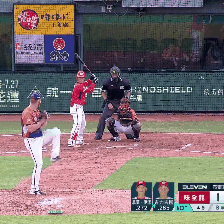

In [ ]:
test_video = np.random.choice(test_df["video_name"].values.tolist())
print(f"Test video path: {test_video}")
test_frames = sequence_prediction(test_video, 'test')
to_gif(test_frames[:MAX_SEQ_LENGTH])

Test video path: 0707_2-10.mp4
  三振: 66.75%
  純粹滾地: 17.78%
  純粹高飛: 15.47%


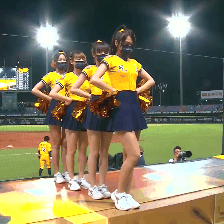

In [ ]:
random_video = np.random.choice(random_df["video_name"].values.tolist())
print(f"Test video path: {random_video}")
random_frames = sequence_prediction(random_video, 'random')
to_gif(random_frames[:MAX_SEQ_LENGTH])